<a href="https://colab.research.google.com/github/shubhu1026/AI-ML/blob/main/Kevares_YOLO_Dataset_Setup_and_Model_Try.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Mounting Google Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 977.1/977.1 kB 24.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 106.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 28.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 53.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 10.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 51.8 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstal

### Importing Dataset

In [ ]:
import zipfile

zip_file_path = '/content/drive/MyDrive/AI Capstone/Kevares Final.zip'
unzip_dir = '/content/Kevares Final/'

with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(unzip_dir)

print("Files unzipped successfully!")

Files unzipped successfully!


In [ ]:
class_mapping = {
    "plastic trash": 0,
    "paper trash": 1,
    "cans": 2,
    "cigarette trash": 3
}

In [ ]:
class_distribution = {0: 0, 1: 0, 2: 0, 3: 0}

### Converting Json Label File to Proper YOLO txt Format

In [ ]:
import json
import os
from PIL import Image

# Define a function to calculate the bounding box from points
def get_bounding_box(points):
    min_x = min([point[0] for point in points])
    max_x = max([point[0] for point in points])
    min_y = min([point[1] for point in points])
    max_y = max([point[1] for point in points])

    # YOLO format bounding box: center_x, center_y, width, height
    center_x = (min_x + max_x) / 2
    center_y = (min_y + max_y) / 2
    width = max_x - min_x
    height = max_y - min_y

    return center_x, center_y, width, height

# Define a function to convert JSON to YOLO format for images <= 211
def convert_json_to_yolo(json_file, image_path):
    with open(json_file, 'r') as f:
        data = json.load(f)

    yolo_format_labels = []

    for shape in data['shapes']:
        label = shape['label']
        points = shape['points']

        # Get the bounding box for the polygon
        center_x, center_y, width, height = get_bounding_box(points)

        # Get image width and height
        with Image.open(image_path) as img:
            image_width, image_height = img.size

        # Normalize by the image dimensions
        center_x /= image_width
        center_y /= image_height
        width /= image_width
        height /= image_height

        class_id = class_mapping.get(label, -1)
        if class_id == -1:
            print(f"Warning: Unknown class '{label}' in {json_file}. Skipping this label.")
            continue

        class_distribution[class_id] += 1
        yolo_format_labels.append(f"{class_id} {center_x} {center_y} {width} {height}")

    return yolo_format_labels

folder = '/content/Kevares Final/Kevares Final/'

output_folder = '/content/Kevares Final/yolo_labels/'
os.makedirs(output_folder, exist_ok=True)

for file_name in os.listdir(folder):
    if file_name.lower().endswith('.json'):
        json_path = os.path.join(folder, file_name)

        image_number = int(os.path.splitext(file_name)[0])

        print(f"Processing {file_name}, image number: {image_number}")

        if image_number <= 211:  # For images under 211
            print(f"Processing {file_name} (image number {image_number} <= 211).")
            image_name = f"{image_number}.jpg"
            image_path = os.path.join(folder, image_name)

            if not os.path.exists(image_path):
                print(f"Warning: Image file {image_name} not found. Skipping {json_path}.")
                continue

            yolo_labels = convert_json_to_yolo(json_path, image_path)

            yolo_label_file = os.path.join(output_folder, os.path.splitext(file_name)[0] + '.txt')
            with open(yolo_label_file, 'w') as f:
                for label in yolo_labels:
                    f.write(label + '\n')

            print(f"Converted {file_name} to YOLO format.")

        else:  # For images over 211
            print(f"Processing {file_name} (image number {image_number} > 211).")

            image_name = f"{image_number}.jpg"
            image_path = os.path.join(folder, image_name)

            if not os.path.exists(image_path):
                print(f"Warning: Image file {image_name} not found. Skipping {json_path}.")
                continue

            yolo_labels = convert_json_to_yolo(json_path, image_path)

            yolo_label_file = os.path.join(output_folder, os.path.splitext(file_name)[0] + '.txt')
            with open(yolo_label_file, 'w') as f:
                for label in yolo_labels:
                    f.write(label + '\n')

            print(f"Converted {file_name} to YOLO format for images over 211.")

print("All files have been successfully converted.")


Processing 238.json, image number: 238
Processing 238.json (image number 238 > 211).
Converted 238.json to YOLO format for images over 211.
Processing 15.json, image number: 15
Processing 15.json (image number 15 <= 211).
Converted 15.json to YOLO format.
Processing 259.json, image number: 259
Processing 259.json (image number 259 > 211).
Converted 259.json to YOLO format for images over 211.
Processing 96.json, image number: 96
Processing 96.json (image number 96 <= 211).
Converted 96.json to YOLO format.
Processing 142.json, image number: 142
Processing 142.json (image number 142 <= 211).
Converted 142.json to YOLO format.
Processing 61.json, image number: 61
Processing 61.json (image number 61 <= 211).
Converted 61.json to YOLO format.
Processing 235.json, image number: 235
Processing 235.json (image number 235 > 211).
Converted 235.json to YOLO format for images over 211.
Processing 367.json, image number: 367
Processing 367.json (image number 367 > 211).
Converted 367.json to YOLO

### Deleting the JSON Label files

In [ ]:
import os

folder_path = '/content/Kevares Final/Kevares Final'

for file_name in os.listdir(folder_path):
    if file_name.lower().endswith('.json'):
        file_path = os.path.join(folder_path, file_name)

        os.remove(file_path)
        print(f"Deleted: {file_name}")

print("All .json files have been deleted.")

Deleted: 238.json
Deleted: 15.json
Deleted: 259.json
Deleted: 96.json
Deleted: 142.json
Deleted: 61.json
Deleted: 235.json
Deleted: 367.json
Deleted: 214.json
Deleted: 247.json
Deleted: 78.json
Deleted: 121.json
Deleted: 270.json
Deleted: 329.json
Deleted: 98.json
Deleted: 92.json
Deleted: 154.json
Deleted: 396.json
Deleted: 297.json
Deleted: 388.json
Deleted: 151.json
Deleted: 326.json
Deleted: 126.json
Deleted: 287.json
Deleted: 189.json
Deleted: 234.json
Deleted: 364.json
Deleted: 220.json
Deleted: 201.json
Deleted: 18.json
Deleted: 5.json
Deleted: 208.json
Deleted: 129.json
Deleted: 232.json
Deleted: 102.json
Deleted: 249.json
Deleted: 225.json
Deleted: 295.json
Deleted: 338.json
Deleted: 228.json
Deleted: 65.json
Deleted: 32.json
Deleted: 173.json
Deleted: 216.json
Deleted: 110.json
Deleted: 114.json
Deleted: 313.json
Deleted: 236.json
Deleted: 181.json
Deleted: 227.json
Deleted: 339.json
Deleted: 9.json
Deleted: 317.json
Deleted: 39.json
Deleted: 100.json
Deleted: 243.json
Delete

### Class Distributions

In [ ]:
print("\nClass distribution:")
for class_id, count in class_distribution.items():
    class_name = list(class_mapping.keys())[list(class_mapping.values()).index(class_id)]
    print(f"{class_name}: {count}")


Class distribution:
plastic trash: 276
paper trash: 259
cans: 61
cigarette trash: 244


### Plotting Sample Bounding Boxes

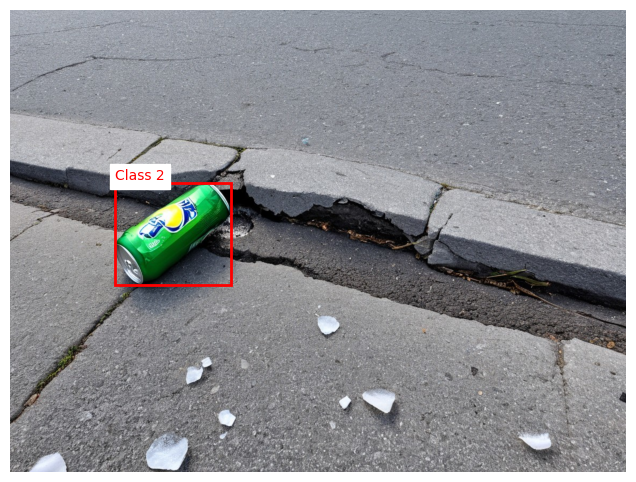

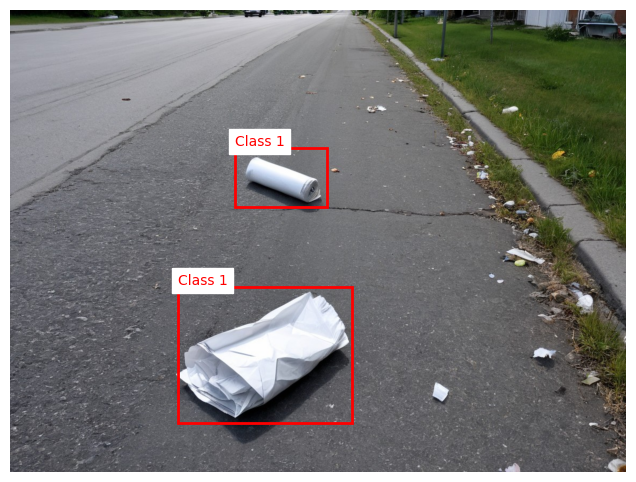

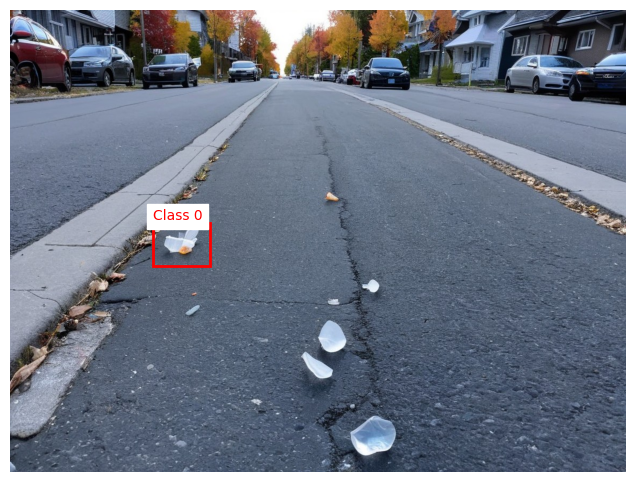

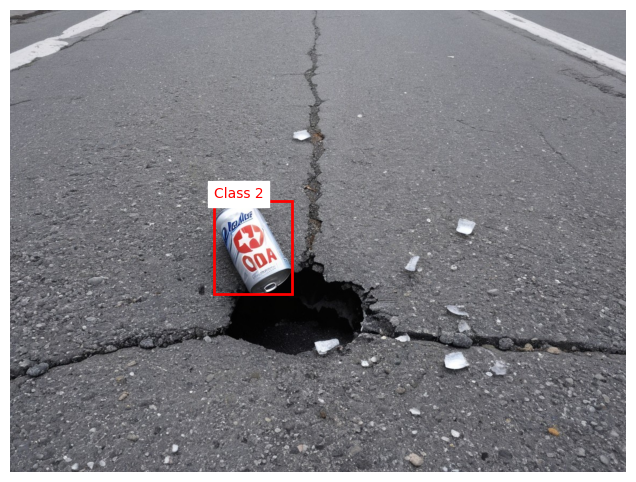

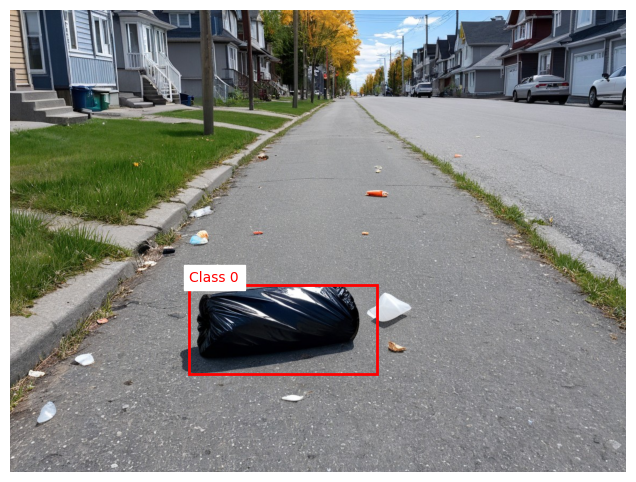

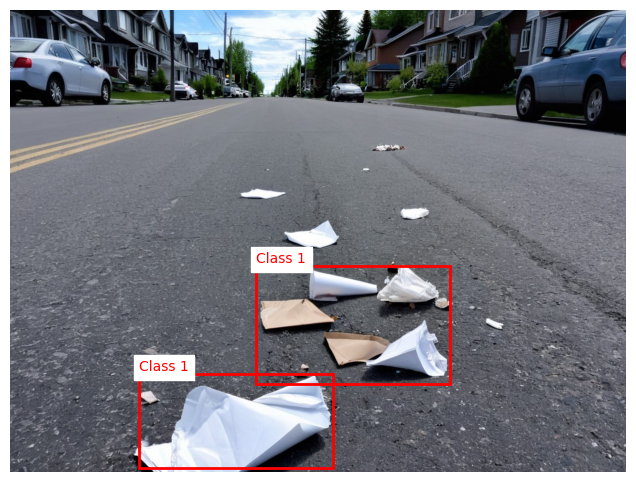

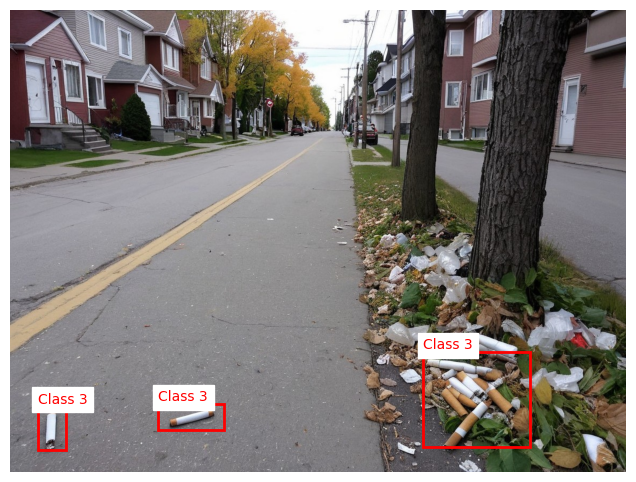

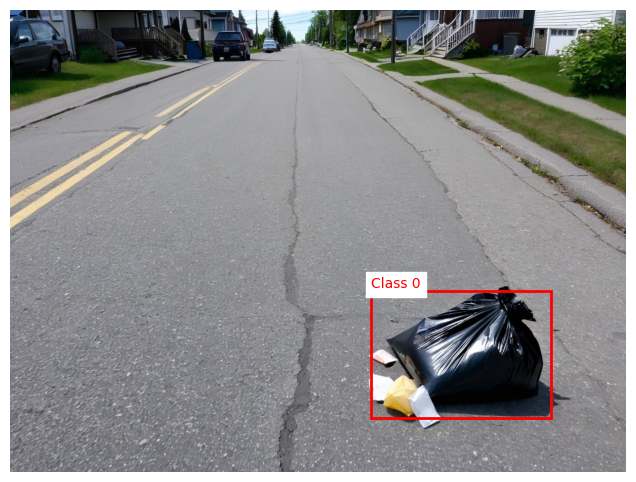

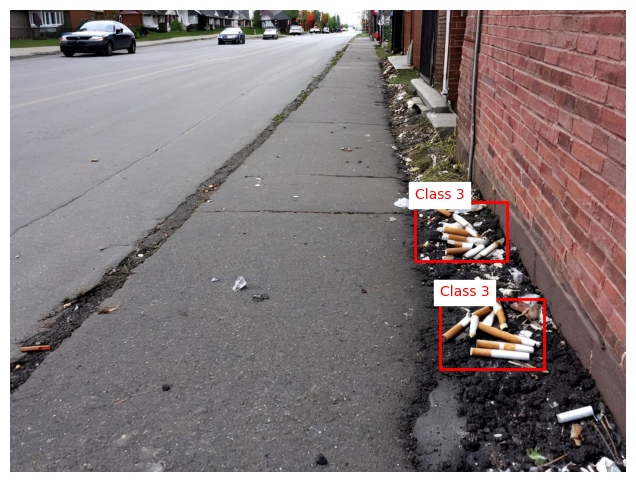

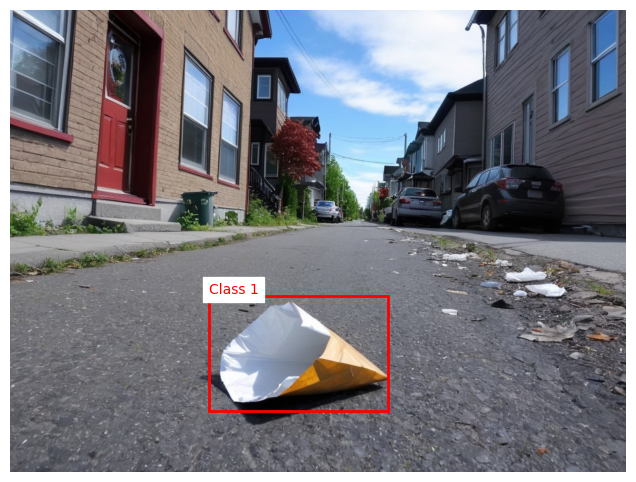

In [ ]:
import os
import cv2
import random
import matplotlib.pyplot as plt
import matplotlib.patches as patches

def plot_sample_bboxes_TACO(image_dir, label_dir, num_samples=5):
    label_files = [f for f in os.listdir(label_dir) if f.endswith(".txt")]

    selected_labels = random.sample(label_files, min(num_samples, len(label_files)))

    for label_file in selected_labels:
        label_path = os.path.join(label_dir, label_file)
        image_path = os.path.join(image_dir, label_file.replace(".txt", ".jpg"))

        if not os.path.exists(image_path):
            print(f"Skipping {label_file}: Image not found")
            continue

        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        # Read bounding boxes
        with open(label_path, "r") as file:
            lines = file.readlines()

        h, w, _ = image.shape

        # Plot image
        fig, ax = plt.subplots(1, figsize=(8, 6))
        ax.imshow(image)

        for line in lines:
            parts = line.strip().split()
            class_id = int(float(parts[0]))
            x_center, y_center, bbox_width, bbox_height = map(float, parts[1:])

            # Convert YOLO format to pixel values
            x_min = int((x_center - bbox_width / 2) * w)
            y_min = int((y_center - bbox_height / 2) * h)
            bbox_width = int(bbox_width * w)
            bbox_height = int(bbox_height * h)

            # Draw bounding box
            rect = patches.Rectangle(
                (x_min, y_min), bbox_width, bbox_height,
                linewidth=2, edgecolor='red', facecolor='none'
            )
            ax.add_patch(rect)
            ax.text(x_min, y_min - 5, f"Class {class_id}", color='red', fontsize=10, backgroundcolor='white')

        # Show the image with bounding boxes
        plt.axis("off")
        plt.show()

plot_sample_bboxes_TACO("/content/Kevares Final/Kevares Final", "/content/Kevares Final/yolo_labels", num_samples=10)

### Dataset Renaming and Zipping

In [ ]:
import os

old_name = "/content/Kevares Final/Kevares Final"
new_name = "/content/Kevares Final/Images"

os.rename(old_name, new_name)


old_name = "/content/Kevares Final/yolo_labels"
new_name = "/content/Kevares Final/Labels"

os.rename(old_name, new_name)

In [ ]:
import shutil

folder_path = '/content/Kevares Final/'
zip_path = '/content/Kevares_Final.zip'

shutil.make_archive(zip_path.replace('.zip', ''), 'zip', folder_path)

print(f"Folder '{folder_path}' has been zipped as '{zip_path}'")

Folder '/content/Kevares Final/' has been zipped as '/content/Kevares_Final.zip'


### Augmentation

In [ ]:
!pip install albumentations

In [ ]:
import os
import cv2
import numpy as np
import albumentations as A
from albumentations.pytorch import ToTensorV2
import torch

def read_yolo_labels(label_file):
    with open(label_file, 'r') as f:
        lines = f.readlines()
    boxes = []
    for line in lines:
        label_data = list(map(float, line.strip().split()))
        boxes.append(label_data)
    return np.array(boxes)

def write_yolo_labels(label_file, boxes):
    with open(label_file, 'w') as f:
        for box in boxes:
            f.write(" ".join(map(str, box)) + "\n")

# Apply augmentation to an image and its corresponding YOLO labels
def augment_image_and_labels(image, labels, augmentations):
    augmented = augmentations(image=image, bboxes=labels[:, 1:], class_labels=labels[:, 0])
    augmented_image = augmented['image']
    augmented_bboxes = np.array(augmented['bboxes'])
    augmented_class_labels = np.array(augmented['class_labels'])

    augmented_image = augmented_image.permute(1, 2, 0).numpy()

    augmented_labels = np.column_stack((augmented_class_labels, augmented_bboxes))
    return augmented_image, augmented_labels

# Augmentation pipeline
augmentation_pipeline = A.Compose([
    A.HorizontalFlip(p=0.5),                # Random horizontal flip
    A.RandomRotate90(p=0.5),                # Random 90-degree rotation (good for different orientations)
    A.RandomBrightnessContrast(p=0.2),      # Random brightness/contrast adjustment
    A.RandomGamma(p=0.2),                   # Random gamma adjustment to handle varying lighting conditions
    A.RandomScale(p=0.2),                   # Random scaling of the image
    A.ShiftScaleRotate(shift_limit=0.1, scale_limit=0.1, rotate_limit=20, p=0.5), # Shift, scale, and rotate
    A.Resize(640, 640),                     # Resize to a fixed size (256x256 in this case)
    A.RandomCrop(width=640, height=640, p=0.5),  # Random crop to simulate occlusions
    A.ElasticTransform(alpha=1, sigma=50, p=0.2),  # Elastic distortion (helps model generalize better)
    A.Perspective(p=0.3),                  # Perspective transformation for variation in viewpoints
    A.MotionBlur(p=0.2),                   # Motion blur to simulate real-world noise
    A.GaussNoise(p=0.2),                   # Gaussian noise to improve robustness
    A.CLAHE(p=0.1, clip_limit=(1, 4)),      # CLAHE for contrast enhancement (improves visibility of small objects)
    A.HueSaturationValue(hue_shift_limit=20, sat_shift_limit=30, val_shift_limit=20, p=0.3),  # Color shifting
    A.Affine(scale=(0.8, 1.2), translate_percent=(0.1, 0.2), p=0.4),  # Scaling and translation
    ToTensorV2(),                          # Convert to PyTorch tensors
], bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']))

input_image_folder = "/content/Kevares Final/Images"
input_label_folder = "/content/Kevares Final/Labels"
output_image_folder = "/content/Kevares/Augmented_Images"
output_label_folder = "/content/Kevares/Augmented_Labels"

os.makedirs(output_image_folder, exist_ok=True)
os.makedirs(output_label_folder, exist_ok=True)

augmentation_factor = 10

# Iterate over your images and labels
for filename in os.listdir(input_image_folder):
    if filename.endswith(".jpg") or filename.endswith(".png"):
        label_file = os.path.join(input_label_folder, filename.replace('.jpg', '.txt').replace('.png', '.txt'))

        if os.path.exists(label_file):
            image_path = os.path.join(input_image_folder, filename)
            image = cv2.imread(image_path)

            labels = read_yolo_labels(label_file)

            for i in range(augmentation_factor):
                augmented_image, augmented_labels = augment_image_and_labels(image, labels, augmentation_pipeline)

                augmented_image_path = os.path.join(output_image_folder, f"{filename.replace('.jpg', '')}_aug{i}.jpg")
                cv2.imwrite(augmented_image_path, augmented_image)

                augmented_label_file = os.path.join(output_label_folder, f"{filename.replace('.jpg', '')}_aug{i}.txt")
                write_yolo_labels(augmented_label_file, augmented_labels)

/usr/local/lib/python3.11/dist-packages/albumentations/core/validation.py:87: UserWarning: ShiftScaleRotate is a special case of Affine transform. Please use Affine transform instead.
  original_init(self, **validated_kwargs)


In [ ]:
directory_path = '/content/Kevares/Augmented_Labels'

files = [f for f in os.listdir(directory_path) if os.path.isfile(os.path.join(directory_path, f))]

num_files = len(files)

print(f'Number of files in the directory: {num_files}')

Number of files in the directory: 3910


### Plotting Bounding Boxes on Augmented Images

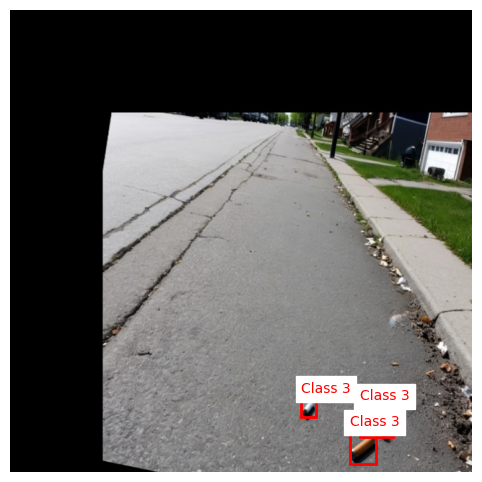

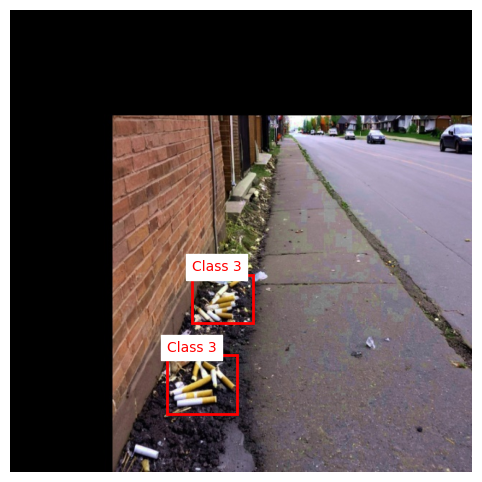

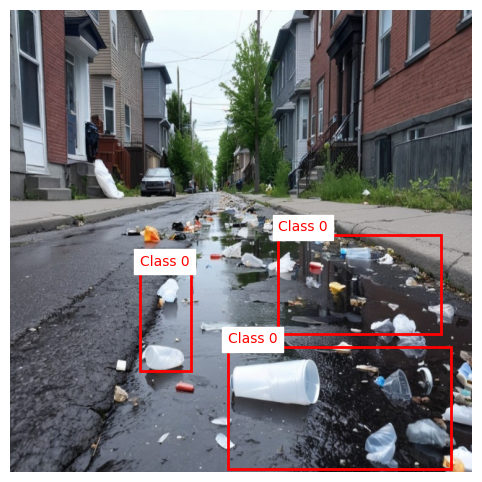

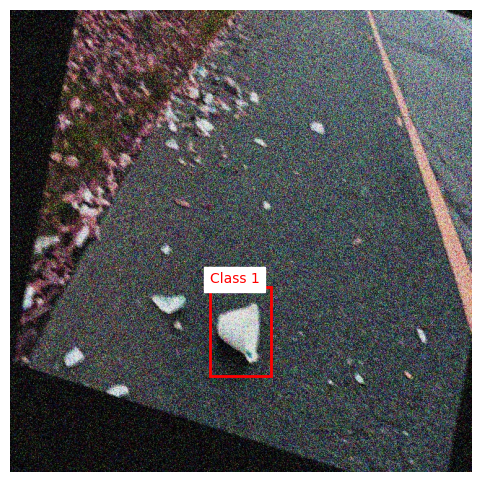

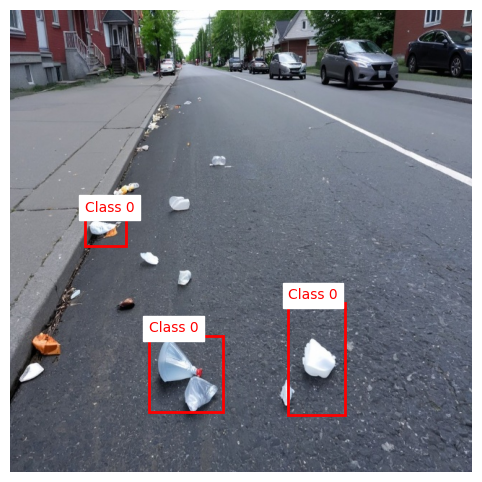

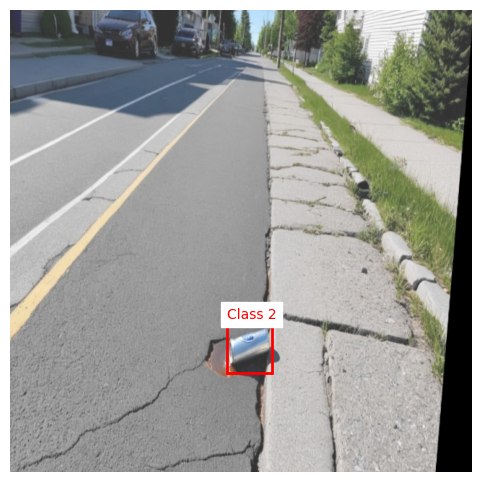

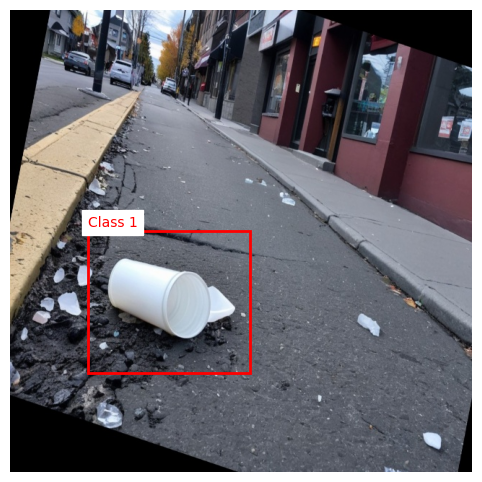

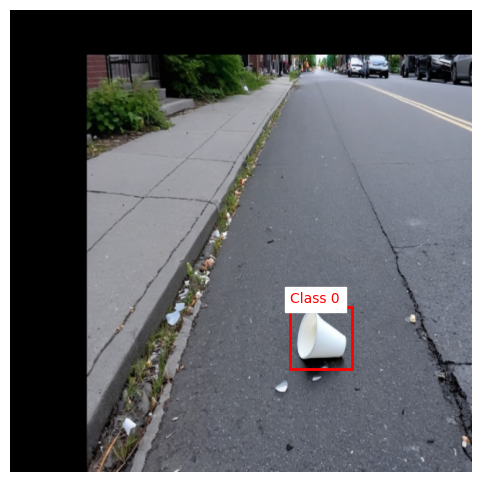

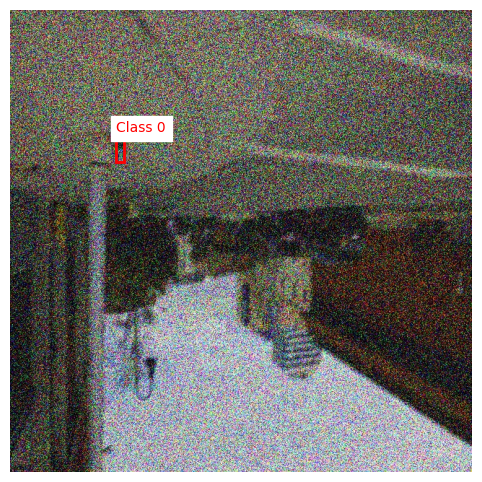

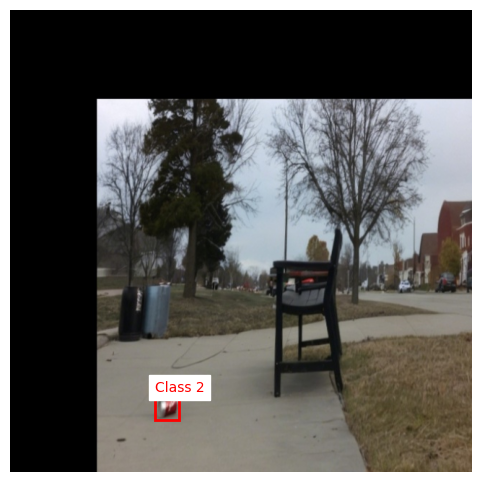

In [ ]:
plot_sample_bboxes_TACO("/content/Kevares/Augmented_Images", "/content/Kevares/Augmented_Labels", num_samples=10)

### Splitting into Train and Val data

In [ ]:
import os
import shutil
import random

images_dir = "/content/Kevares/Augmented_Images"
labels_dir = "/content/Kevares/Augmented_Labels"

train_images_dir = "/content/Kevares new/images/train"
val_images_dir = "/content/Kevares new/images/val"
train_labels_dir = "/content/Kevares new/labels/train"
val_labels_dir = "/content/Kevares new/labels/val"

os.makedirs(train_images_dir, exist_ok=True)
os.makedirs(val_images_dir, exist_ok=True)
os.makedirs(train_labels_dir, exist_ok=True)
os.makedirs(val_labels_dir, exist_ok=True)

image_files = [f for f in os.listdir(images_dir) if f.endswith(('.jpg', '.png'))]

random.shuffle(image_files)

split_ratio = 0.8
train_size = int(len(image_files) * split_ratio)
train_files = image_files[:train_size]
val_files = image_files[train_size:]

for image_file in train_files:
    label_file = image_file.replace('.jpg', '.txt').replace('.png', '.txt')
    shutil.move(os.path.join(images_dir, image_file), os.path.join(train_images_dir, image_file))
    shutil.move(os.path.join(labels_dir, label_file), os.path.join(train_labels_dir, label_file))

for image_file in val_files:
    label_file = image_file.replace('.jpg', '.txt').replace('.png', '.txt')
    shutil.move(os.path.join(images_dir, image_file), os.path.join(val_images_dir, image_file))
    shutil.move(os.path.join(labels_dir, label_file), os.path.join(val_labels_dir, label_file))

print(f"Training images: {len(train_files)}")
print(f"Validation images: {len(val_files)}")

Training images: 3128
Validation images: 782


### Creating the Training YAML file

In [ ]:
import os

train_images_dir = "/content/Kevares new/images/train"
val_images_dir = "/content/Kevares new/images/val"

classes = ['plastic trash', 'paper trash', 'cans', 'cigarette trash']
num_classes = len(classes)

yaml_file_path = "/content/Kevares new/dataset.yaml"

yaml_content = f"""
train: {train_images_dir}  # Path to training images
val: {val_images_dir}      # Path to validation images

# Number of classes
nc: {num_classes}

# Class names
names:
"""
for i, class_name in enumerate(classes):
    yaml_content += f"  {i}: '{class_name}'\n"

with open(yaml_file_path, 'w') as f:
    f.write(yaml_content)

print(f"Dataset YAML file created at: {yaml_file_path}")

Dataset YAML file created at: /content/Kevares new/dataset.yaml


In [ ]:
!pip install ultralytics

### Loading the TACO YOLO model and training on our Dataset

In [ ]:
from ultralytics import YOLO

model = YOLO("/content/best (5).pt")

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
results = model.train(
    data="/content/Kevares new/dataset.yaml",
    epochs=100,
    imgsz=640,
    patience=5,
    freeze=5,
    # resume=True,
    lr0=0.00001,
    save=True,
)

Ultralytics 8.3.100 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=/content/best (5).pt, data=/content/Kevares new/dataset.yaml, epochs=100, time=None, patience=5, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=5, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=Tr

100%|██████████| 755k/755k [00:00<00:00, 21.8MB/s]


Overriding model.yaml nc=18 with nc=4

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      6640  ultralytics.nn.modules.block.C3k2            [32, 64, 1, False, 0.25]      
  3                  -1  1     36992  ultralytics.nn.modules.conv.Conv             [64, 64, 3, 2]                
  4                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  5                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
  6                  -1  1     87040  ultralytics.nn.modules.block.C3k2            [128, 128, 1, True]           
  7                  -1  1    295424  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 113MB/s]


AMP: checks passed ✅


train: Scanning /content/Kevares new/labels/train... 3128 images, 156 backgrounds, 0 corrupt: 100%|██████████| 3128/3128 [00:01<00:00, 2428.85it/s]


train: New cache created: /content/Kevares new/labels/train.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/Kevares new/labels/val... 782 images, 56 backgrounds, 0 corrupt: 100%|██████████| 782/782 [00:00<00:00, 930.04it/s]


val: New cache created: /content/Kevares new/labels/val.cache
Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=1e-05' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.00125, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      1.59G      1.773      3.119      1.421         36        640: 100%|██████████| 196/196 [01:06<00:00,  2.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:09<00:00,  2.65it/s]

                   all        782       1589      0.473      0.385      0.376      0.194



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      2.12G      1.716      2.278      1.392         27        640: 100%|██████████| 196/196 [01:00<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08<00:00,  2.87it/s]


                   all        782       1589      0.517      0.441      0.441       0.23

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      2.14G      1.714      2.082      1.389         41        640: 100%|██████████| 196/196 [00:59<00:00,  3.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:09<00:00,  2.73it/s]

                   all        782       1589      0.509      0.411      0.415      0.222



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      2.15G      1.725      1.989      1.419         29        640: 100%|██████████| 196/196 [01:00<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:09<00:00,  2.74it/s]


                   all        782       1589      0.554      0.424      0.456      0.238

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      2.16G       1.69       1.89      1.401         21        640: 100%|██████████| 196/196 [01:01<00:00,  3.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08<00:00,  2.89it/s]

                   all        782       1589      0.522      0.466      0.469      0.258



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      2.18G      1.652      1.806      1.386         17        640: 100%|██████████| 196/196 [01:00<00:00,  3.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:07<00:00,  3.34it/s]


                   all        782       1589      0.537      0.496      0.503      0.266

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      2.19G      1.658      1.752      1.383         26        640: 100%|██████████| 196/196 [01:01<00:00,  3.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:07<00:00,  3.48it/s]


                   all        782       1589       0.58      0.488      0.505      0.278

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      2.21G      1.636      1.711       1.37         23        640: 100%|██████████| 196/196 [00:59<00:00,  3.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08<00:00,  2.88it/s]


                   all        782       1589      0.607      0.522      0.526       0.28

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      2.22G      1.611      1.655      1.366         20        640: 100%|██████████| 196/196 [01:00<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08<00:00,  2.94it/s]

                   all        782       1589        0.6       0.47      0.517      0.294



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      2.24G        1.6      1.613      1.369         12        640: 100%|██████████| 196/196 [00:58<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08<00:00,  3.12it/s]

                   all        782       1589      0.687      0.536      0.596      0.317



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      2.25G       1.61      1.589       1.37         28        640: 100%|██████████| 196/196 [00:58<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:07<00:00,  3.46it/s]


                   all        782       1589      0.601      0.554       0.57      0.325

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      2.26G      1.576      1.551       1.34         12        640: 100%|██████████| 196/196 [00:58<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08<00:00,  2.86it/s]


                   all        782       1589      0.647      0.525      0.581      0.325

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      2.28G      1.585      1.548       1.35         12        640: 100%|██████████| 196/196 [01:00<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08<00:00,  2.86it/s]


                   all        782       1589      0.635      0.531      0.581      0.325

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      2.29G       1.55      1.493      1.352         13        640: 100%|██████████| 196/196 [00:58<00:00,  3.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08<00:00,  2.91it/s]

                   all        782       1589      0.675      0.556      0.619      0.355



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      2.31G       1.54      1.465       1.33         23        640: 100%|██████████| 196/196 [00:58<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:07<00:00,  3.51it/s]

                   all        782       1589      0.697      0.551      0.623      0.328



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      2.33G      1.522      1.441      1.331          8        640: 100%|██████████| 196/196 [01:00<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:07<00:00,  3.37it/s]


                   all        782       1589      0.685      0.559      0.618      0.351

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      2.34G      1.522      1.408      1.332         19        640: 100%|██████████| 196/196 [01:01<00:00,  3.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:07<00:00,  3.16it/s]


                   all        782       1589      0.691      0.553      0.616      0.359

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      2.35G      1.495      1.383      1.301         16        640: 100%|██████████| 196/196 [00:58<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08<00:00,  2.88it/s]


                   all        782       1589      0.718      0.575      0.648      0.363

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      2.37G      1.495      1.377       1.32         10        640: 100%|██████████| 196/196 [00:58<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:07<00:00,  3.17it/s]

                   all        782       1589      0.682      0.584      0.637      0.383



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      2.38G      1.506      1.356      1.318         16        640: 100%|██████████| 196/196 [00:59<00:00,  3.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:07<00:00,  3.46it/s]


                   all        782       1589      0.694      0.576      0.639      0.385

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      2.39G      1.467       1.35      1.296         18        640: 100%|██████████| 196/196 [01:02<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:07<00:00,  3.43it/s]


                   all        782       1589      0.728      0.615      0.678      0.395

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      2.41G      1.478      1.318      1.304         23        640: 100%|██████████| 196/196 [01:00<00:00,  3.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08<00:00,  2.90it/s]

                   all        782       1589      0.767      0.609      0.682        0.4



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      2.42G      1.481      1.324      1.296         21        640: 100%|██████████| 196/196 [00:58<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08<00:00,  2.89it/s]

                   all        782       1589      0.684      0.606      0.644      0.382



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      2.44G      1.455      1.251      1.293         27        640: 100%|██████████| 196/196 [00:59<00:00,  3.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08<00:00,  2.85it/s]

                   all        782       1589      0.739      0.614      0.678      0.393



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      2.45G      1.446      1.264      1.286         19        640: 100%|██████████| 196/196 [01:01<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:07<00:00,  3.31it/s]

                   all        782       1589      0.711      0.622      0.671      0.398



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      2.47G      1.424      1.231      1.273         22        640: 100%|██████████| 196/196 [01:00<00:00,  3.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:07<00:00,  3.51it/s]


                   all        782       1589      0.749      0.612      0.694      0.407

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      2.48G      1.439      1.231      1.276         43        640: 100%|██████████| 196/196 [01:00<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08<00:00,  3.08it/s]


                   all        782       1589      0.777      0.609      0.697      0.418

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100       2.5G      1.427      1.199      1.274         17        640: 100%|██████████| 196/196 [00:59<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08<00:00,  2.83it/s]


                   all        782       1589      0.778      0.619      0.698      0.419

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      2.51G      1.436      1.194      1.282         18        640: 100%|██████████| 196/196 [01:00<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:07<00:00,  3.28it/s]

                   all        782       1589      0.789      0.621      0.711       0.42



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      2.53G      1.426      1.187      1.271         22        640: 100%|██████████| 196/196 [00:59<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:07<00:00,  3.40it/s]

                   all        782       1589      0.774      0.627      0.708      0.427



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      2.54G       1.41      1.171      1.261         22        640: 100%|██████████| 196/196 [00:59<00:00,  3.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08<00:00,  2.91it/s]


                   all        782       1589       0.76      0.658      0.721      0.438

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      2.55G       1.41      1.166      1.262         17        640: 100%|██████████| 196/196 [00:58<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08<00:00,  2.82it/s]

                   all        782       1589      0.734       0.65      0.694      0.424



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      2.57G      1.416      1.158      1.265         20        640: 100%|██████████| 196/196 [01:00<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08<00:00,  2.85it/s]


                   all        782       1589      0.809      0.629      0.714      0.435

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      2.59G       1.39      1.137      1.252         10        640: 100%|██████████| 196/196 [00:59<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:07<00:00,  3.30it/s]

                   all        782       1589      0.802       0.65      0.723      0.436



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100       2.6G      1.382       1.11      1.242         25        640: 100%|██████████| 196/196 [00:59<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:07<00:00,  3.44it/s]


                   all        782       1589      0.821      0.618      0.725      0.441

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      2.61G      1.369        1.1      1.246         26        640: 100%|██████████| 196/196 [00:58<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08<00:00,  2.83it/s]

                   all        782       1589      0.787       0.65      0.727      0.438



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      2.63G       1.37      1.114       1.24         17        640: 100%|██████████| 196/196 [01:00<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08<00:00,  2.84it/s]


                   all        782       1589       0.76      0.653      0.723      0.428

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      2.64G      1.364      1.075      1.247         16        640: 100%|██████████| 196/196 [00:57<00:00,  3.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:07<00:00,  3.41it/s]

                   all        782       1589      0.788      0.667      0.748      0.455



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      2.66G       1.36      1.065      1.235         19        640: 100%|██████████| 196/196 [00:59<00:00,  3.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:07<00:00,  3.31it/s]


                   all        782       1589       0.78      0.654      0.726      0.434

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      2.67G      1.332      1.046      1.216         13        640: 100%|██████████| 196/196 [00:58<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08<00:00,  2.81it/s]

                   all        782       1589       0.81      0.662       0.75      0.458



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      2.68G      1.353      1.037      1.224         25        640: 100%|██████████| 196/196 [01:00<00:00,  3.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:07<00:00,  3.17it/s]

                   all        782       1589      0.803      0.678      0.746       0.46



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100       2.7G      1.328      1.027      1.225         23        640: 100%|██████████| 196/196 [00:58<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:07<00:00,  3.42it/s]

                   all        782       1589      0.802      0.672      0.744      0.449



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      2.72G      1.325      1.026      1.214          8        640: 100%|██████████| 196/196 [00:58<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08<00:00,  2.92it/s]


                   all        782       1589      0.789      0.674      0.744      0.453

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      2.73G       1.33      1.013      1.207         20        640: 100%|██████████| 196/196 [00:58<00:00,  3.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08<00:00,  2.88it/s]

                   all        782       1589      0.793      0.688      0.753      0.458



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      2.74G      1.327      1.003      1.213         42        640: 100%|██████████| 196/196 [01:00<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:06<00:00,  3.63it/s]

                   all        782       1589      0.799      0.679      0.757      0.453



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      2.76G      1.291     0.9865        1.2         19        640: 100%|██████████| 196/196 [00:58<00:00,  3.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08<00:00,  2.87it/s]

                   all        782       1589      0.779      0.689       0.74      0.441
EarlyStopping: Training stopped early as no improvement observed in last 5 epochs. Best results observed at epoch 41, best model saved as best.pt.
To update EarlyStopping(patience=5) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



46 epochs completed in 0.878 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/train/weights/best.pt, 5.5MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.100 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,932 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:10<00:00,  2.30it/s]


                   all        782       1589      0.796       0.68      0.746       0.46
         plastic trash        341        484      0.739      0.723      0.771      0.512
           paper trash        286        442       0.85      0.744      0.839       0.53
                  cans         95        117      0.849      0.744      0.787      0.543
       cigarette trash        110        546      0.745      0.509      0.587      0.257
Speed: 0.3ms preprocess, 2.8ms inference, 0.0ms loss, 2.8ms postprocess per image
Results saved to runs/detect/train


In [ ]:
results = model.val()

Ultralytics 8.3.100 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,932 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/Kevares new/labels/val.cache... 782 images, 56 backgrounds, 0 corrupt: 100%|██████████| 782/782 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:10<00:00,  4.51it/s]


                   all        782       1589      0.809      0.675      0.745       0.46
         plastic trash        341        484      0.754      0.719      0.771      0.512
           paper trash        286        442      0.863       0.74      0.837      0.532
                  cans         95        117      0.859      0.744      0.787      0.539
       cigarette trash        110        546      0.761      0.498      0.586      0.257
Speed: 1.1ms preprocess, 4.2ms inference, 0.0ms loss, 1.9ms postprocess per image
Results saved to runs/detect/train2


['/content/runs/detect/train/F1_curve.png', '/content/runs/detect/train/PR_curve.png', '/content/runs/detect/train/P_curve.png', '/content/runs/detect/train/R_curve.png', '/content/runs/detect/train/confusion_matrix.png', '/content/runs/detect/train/confusion_matrix_normalized.png', '/content/runs/detect/train/labels.jpg', '/content/runs/detect/train/labels_correlogram.jpg', '/content/runs/detect/train/results.png', '/content/runs/detect/train/train_batch0.jpg', '/content/runs/detect/train/train_batch1.jpg', '/content/runs/detect/train/train_batch2.jpg', '/content/runs/detect/train/val_batch0_labels.jpg', '/content/runs/detect/train/val_batch0_pred.jpg', '/content/runs/detect/train/val_batch1_labels.jpg', '/content/runs/detect/train/val_batch1_pred.jpg', '/content/runs/detect/train/val_batch2_labels.jpg', '/content/runs/detect/train/val_batch2_pred.jpg']


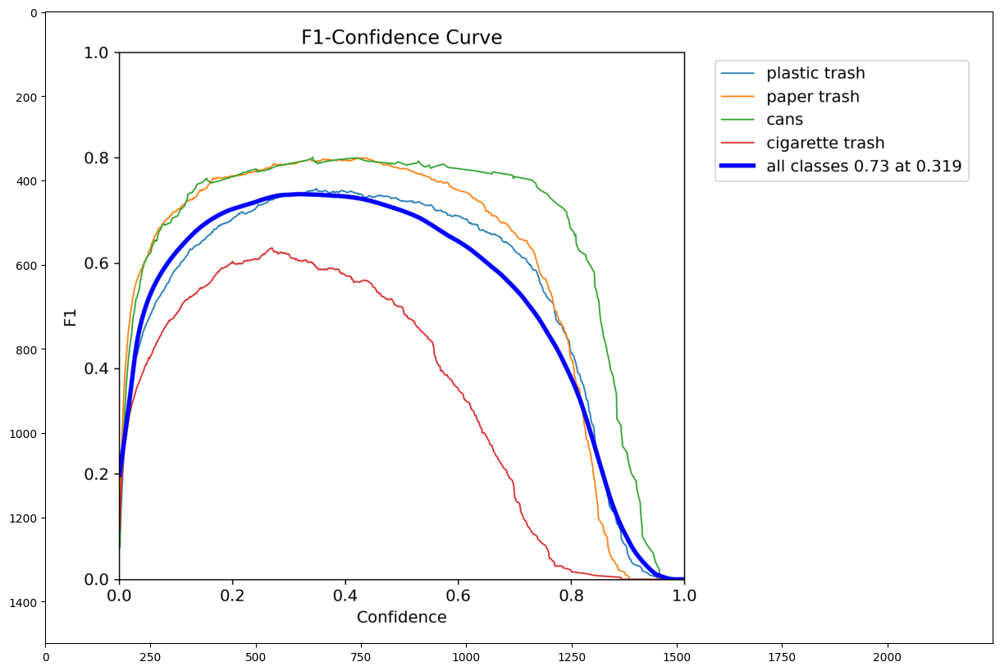

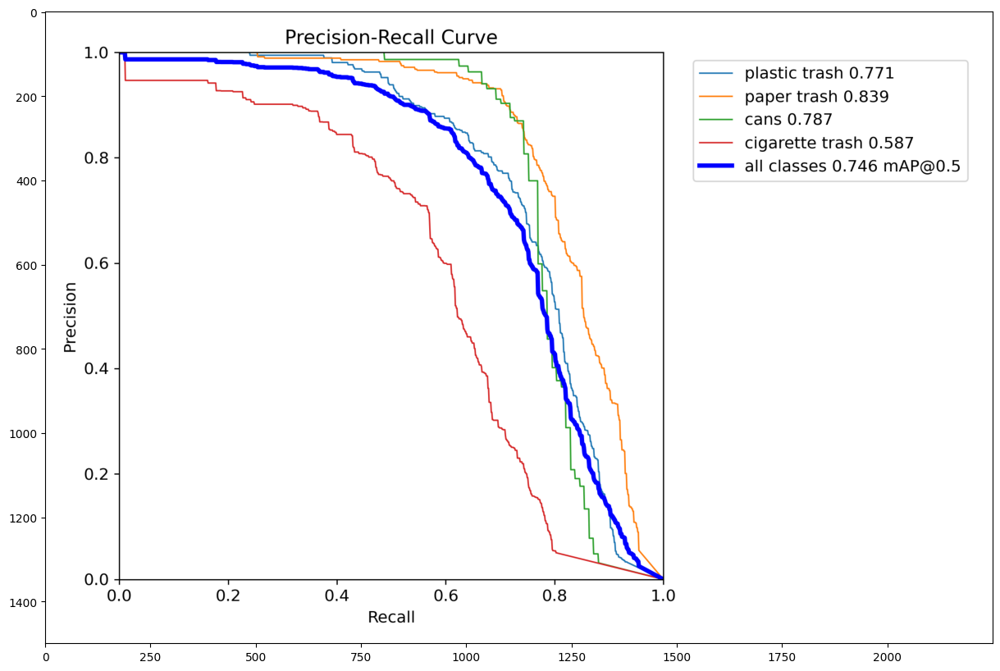

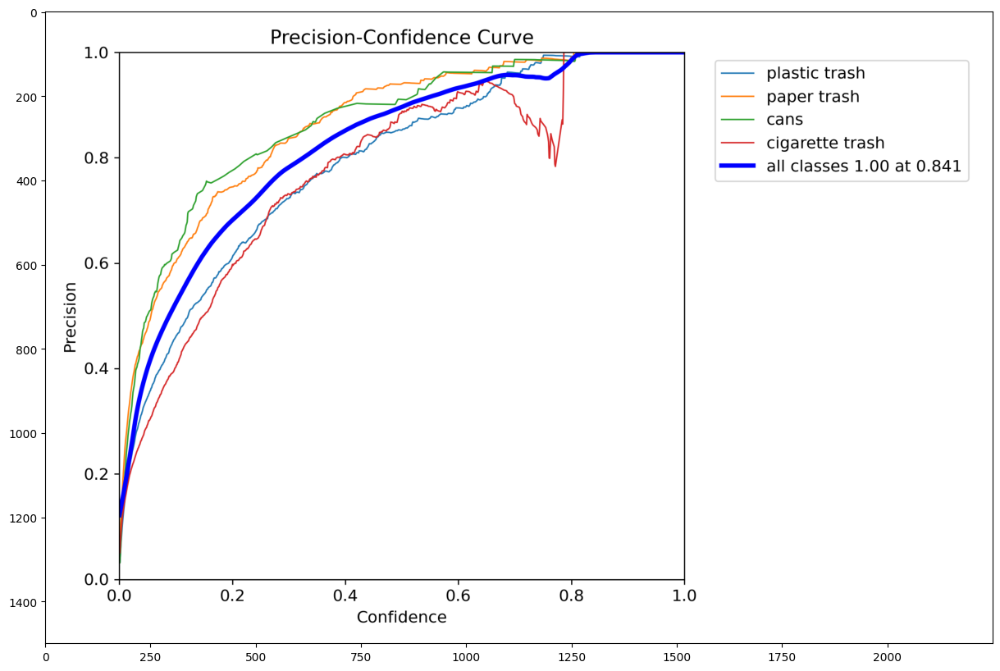

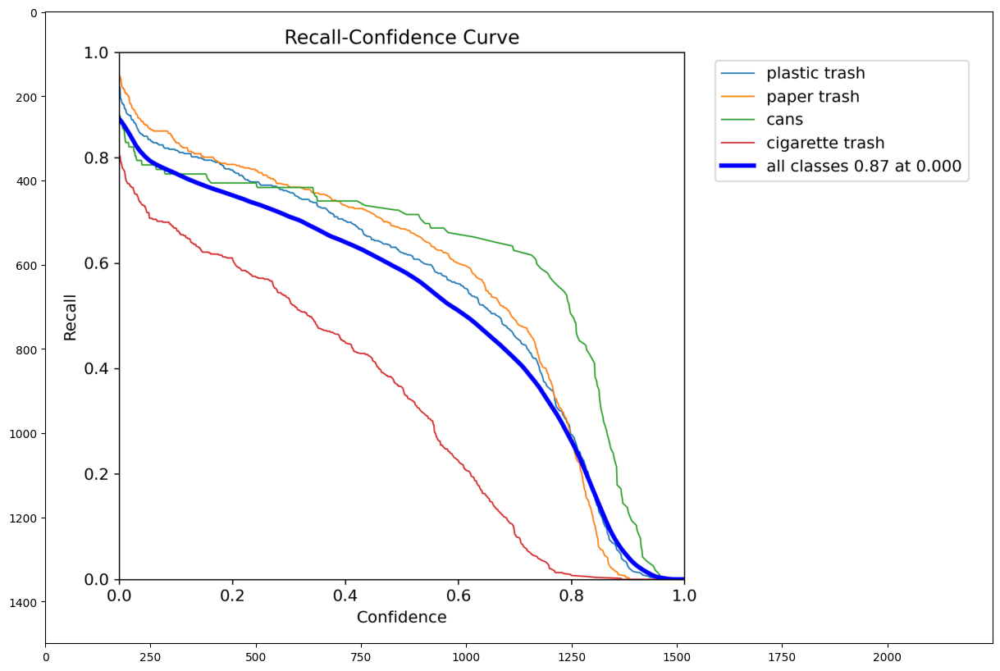

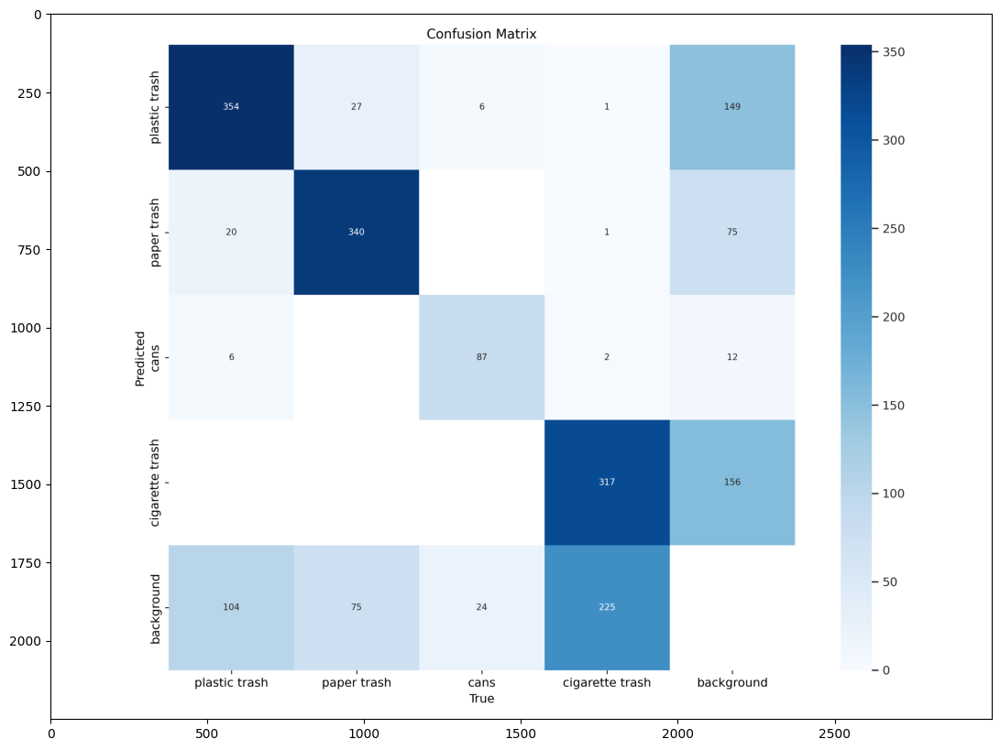

...

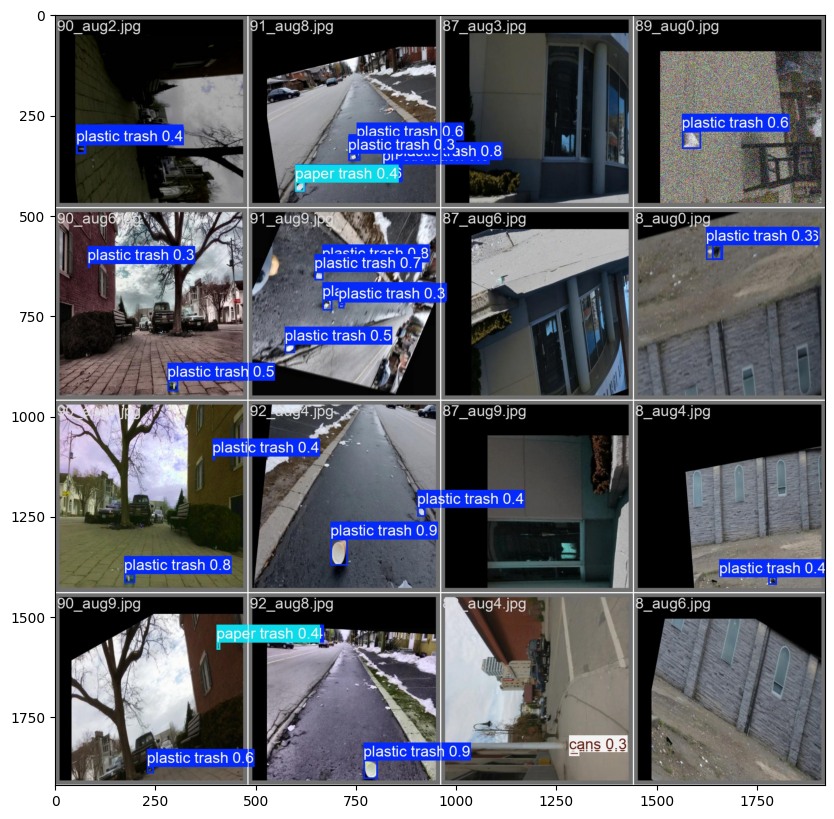

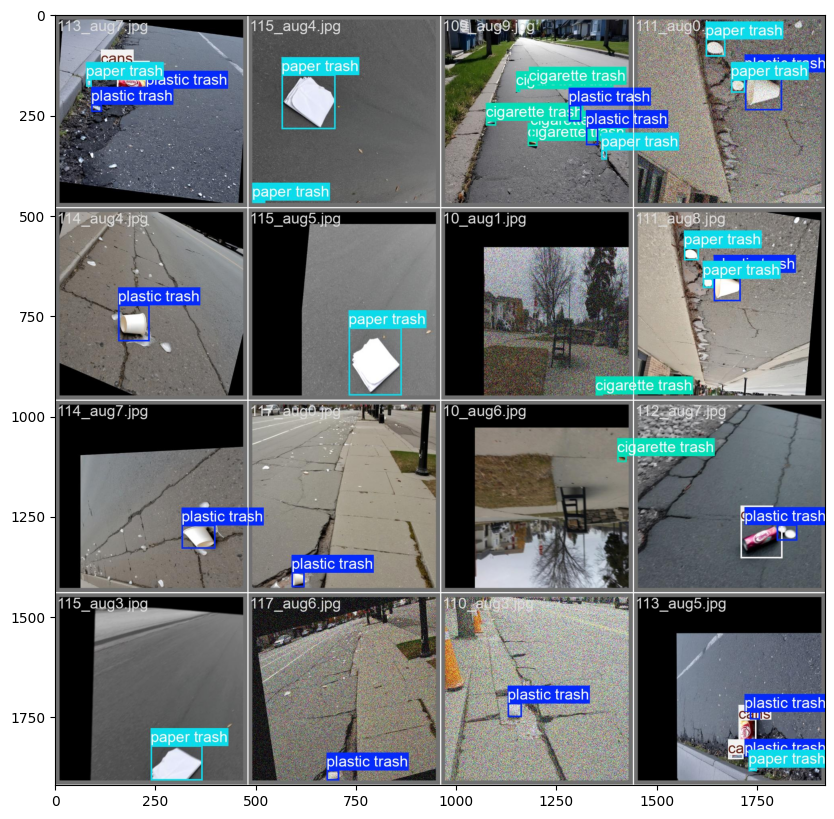

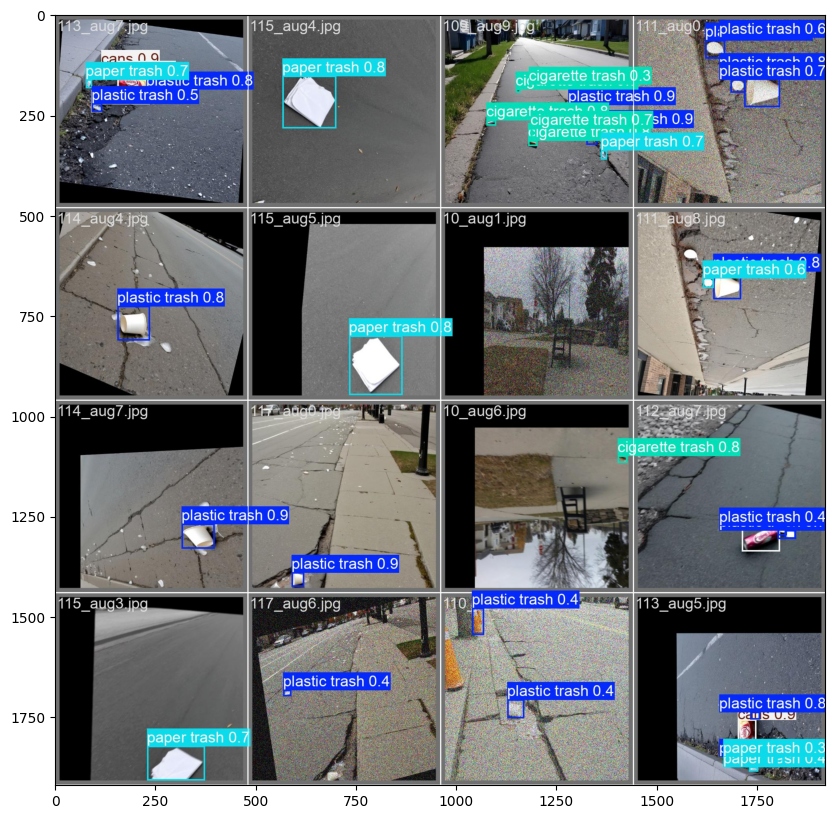

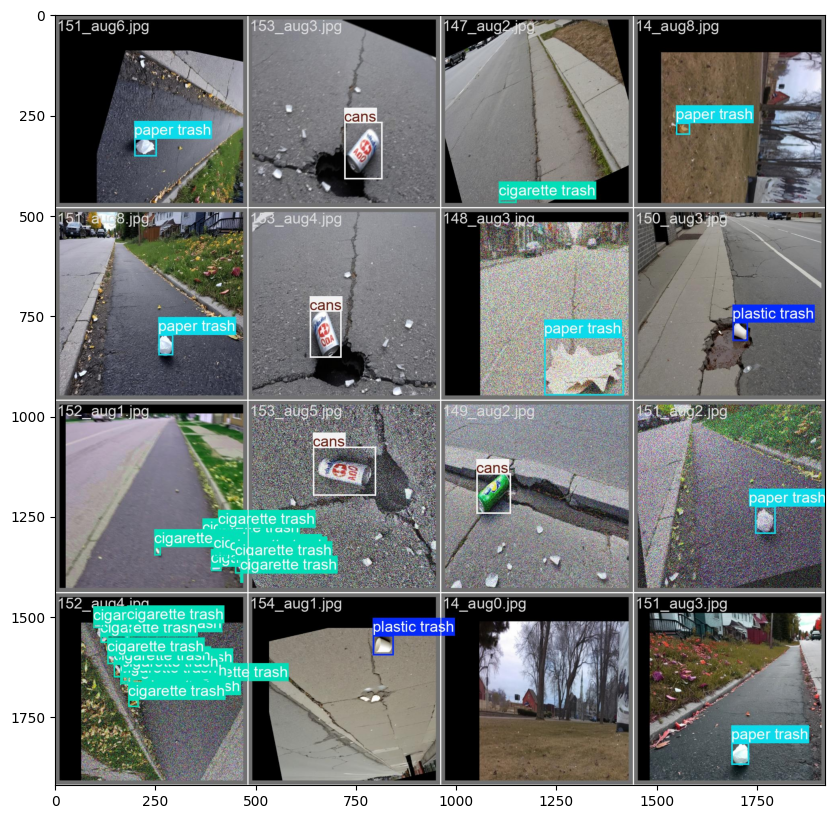

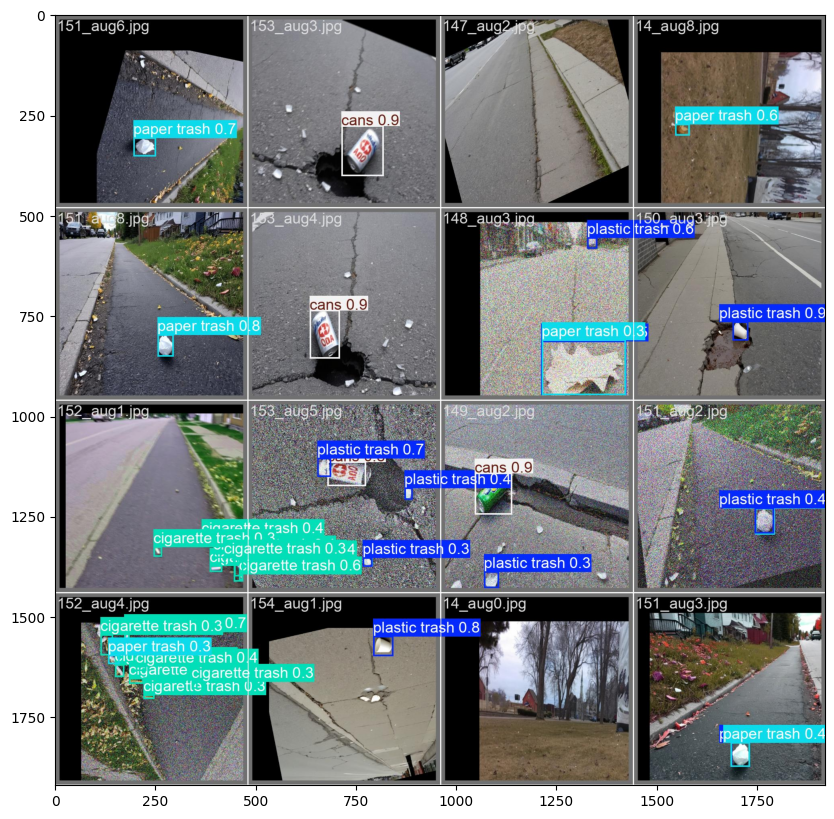

In [ ]:
import os
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np

paths2=[]
for dirname, _, filenames in os.walk('/content/runs/detect/train'):
    for filename in filenames:
        if filename[-4:]=='.jpg' or filename[-4:]=='.png':
            paths2+=[(os.path.join(dirname, filename))]
paths2=sorted(paths2)

print(paths2)

for path in paths2:
    image = Image.open(path)
    image=np.array(image)
    plt.figure(figsize=(20,10))
    plt.imshow(image)
    plt.show()

In [ ]:
!cp /content/runs/detect/train/weights/best.pt "/content/drive/MyDrive/AI Capstone/"


In [ ]:
res = model.predict(source="/content/Kevares Final/Images/104.jpg")


image 1/1 /content/Kevares Final/Images/104.jpg: 384x640 1 plastic trash, 49.5ms
Speed: 2.8ms preprocess, 49.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


In [ ]:
from ultralytics import YOLO

# Load a model
model = YOLO("/content/runs/detect/train/weights/best.pt")

### Model result on Sample Image

In [ ]:
results = model("/content/Kevares Final/Images/1.jpg", show_boxes=True, show_labels=True, show_conf=True)


image 1/1 /content/Kevares Final/Images/1.jpg: 384x640 2 plastic trashs, 11.3ms
Speed: 2.8ms preprocess, 11.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


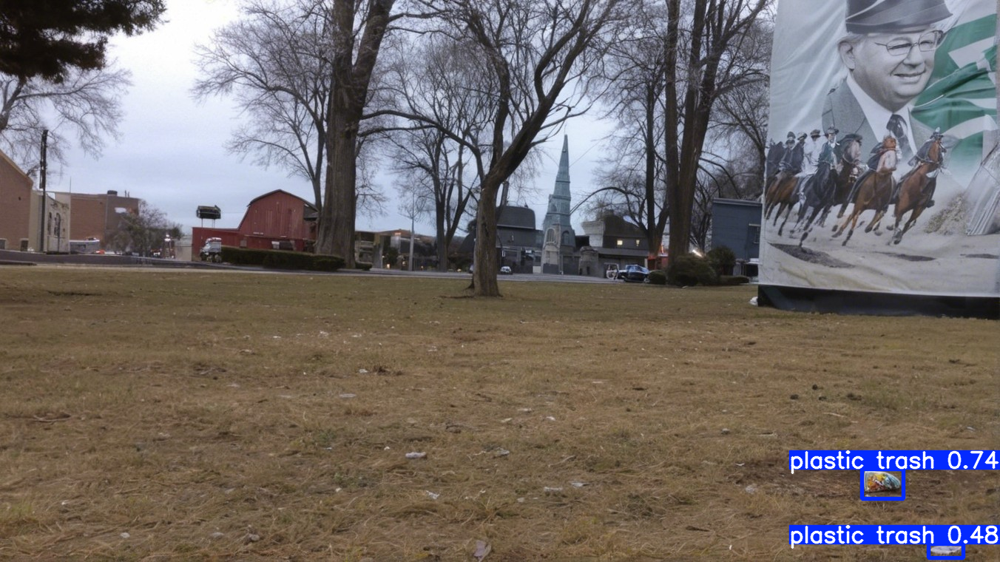

In [ ]:
from PIL import Image

for i, r in enumerate(results):
    im_bgr = r.plot()
    im_rgb = Image.fromarray(im_bgr[..., ::-1])

    r.show()

    r.save(filename=f"results{i}.jpg")


image 1/1 /content/Kevares new/images/val/46_aug5.jpg: 640x640 1 plastic trash, 1 paper trash, 9.0ms
Speed: 2.0ms preprocess, 9.0ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


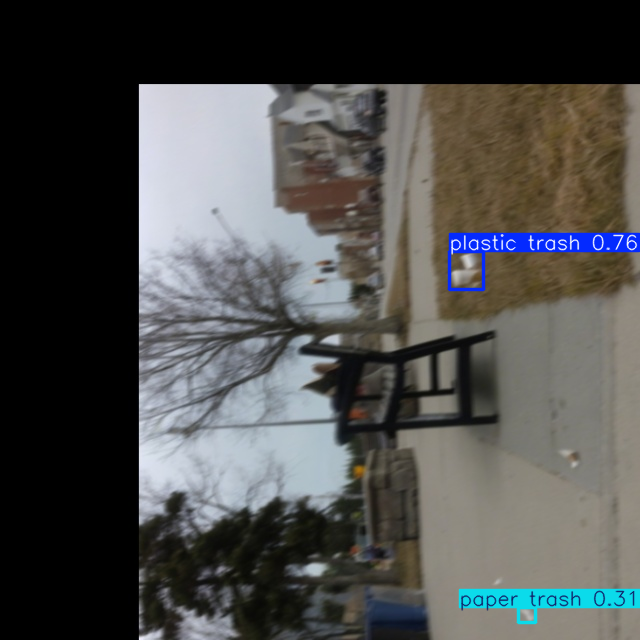


image 1/1 /content/Kevares new/images/val/312_aug4.jpg: 640x640 (no detections), 11.5ms
Speed: 2.4ms preprocess, 11.5ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


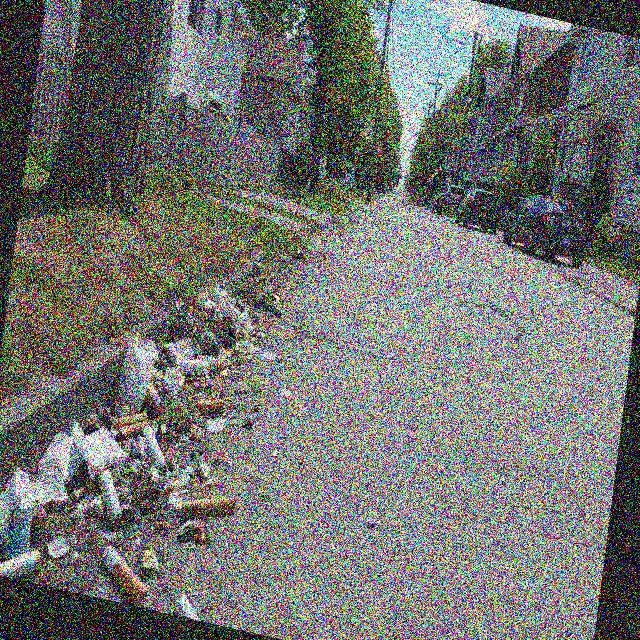


image 1/1 /content/Kevares new/images/val/274_aug4.jpg: 640x640 2 plastic trashs, 12.9ms
Speed: 2.7ms preprocess, 12.9ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


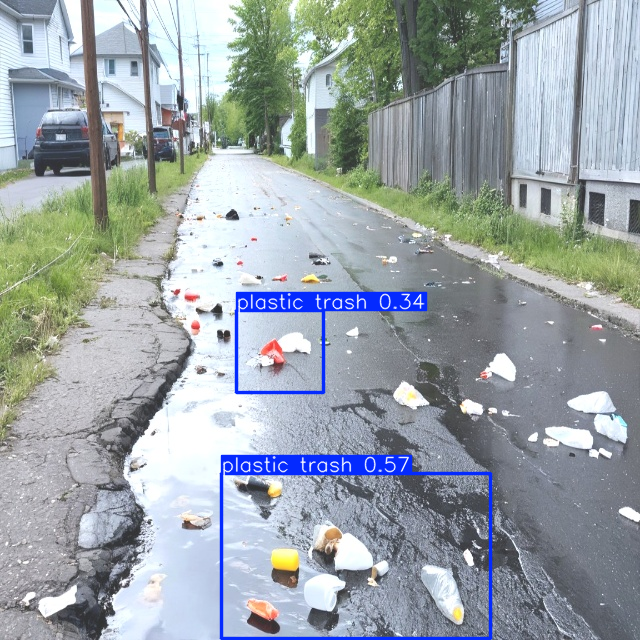


image 1/1 /content/Kevares new/images/val/119_aug1.jpg: 640x640 2 plastic trashs, 3 paper trashs, 21.4ms
Speed: 3.5ms preprocess, 21.4ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


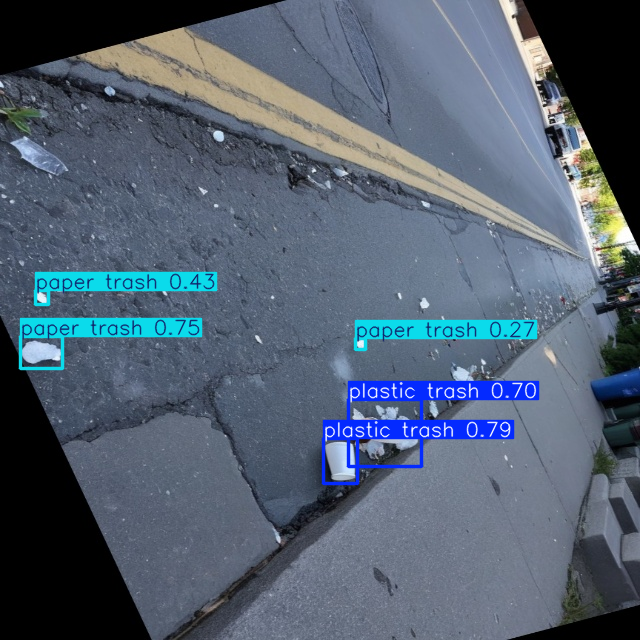


image 1/1 /content/Kevares new/images/val/101_aug8.jpg: 640x640 (no detections), 11.0ms
Speed: 2.2ms preprocess, 11.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


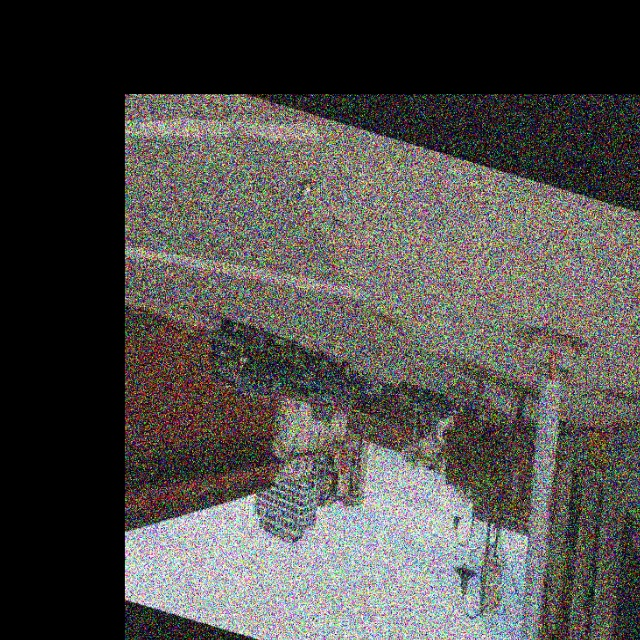

In [ ]:
import random
import glob
from PIL import Image

image_paths = glob.glob("/content/Kevares new/images/val/*.jpg")

random_images = random.sample(image_paths, 5)

for i, img_path in enumerate(random_images):
    results = model(img_path, show_boxes=True, show_labels=True, show_conf=True)

    for j, r in enumerate(results):
        im_bgr = r.plot()
        im_rgb = Image.fromarray(im_bgr[..., ::-1])

        r.show()

        r.save(filename=f"results_{i}_{j}.jpg")

In [ ]:
import shutil

shutil.make_archive('/content/runs_Zip', 'zip', '/content/runs')

'/content/runs_Zip.zip'

In [ ]:
model.val(conf=0.4)

Ultralytics 8.3.100 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)


val: Scanning /content/Kevares new/labels/val.cache... 782 images, 56 backgrounds, 0 corrupt: 100%|██████████| 782/782 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:09<00:00,  5.11it/s]


                   all        782       1589      0.855      0.638       0.77      0.524
         plastic trash        341        484        0.8       0.68       0.78      0.564
           paper trash        286        442      0.905      0.708      0.828      0.575
                  cans         95        117      0.903      0.718      0.838      0.628
       cigarette trash        110        546      0.811      0.447      0.633      0.327
Speed: 1.2ms preprocess, 3.9ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to runs/detect/train4


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7e384da888d0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0